In [1]:
import pandas as pd
import numpy as np
import os
from matplotlib import pyplot as plt
plt.rcParams["figure.figsize"] = (12,12)

In [2]:
filename = '../csv_detection_info/0.csv'
filename_clean = '../csv_detection_info_clean/0.csv'
saved_cropped_image = '//nmbu.no/LargeFile/Project/CubiAI/preprocess/cropped/0'

In [3]:
detection_df = pd.read_csv(filename)
detection_df[detection_df.filename=='1.3.51.0.7.2124647196.62561.64072.35341.15474.45918.19587.dcm']

,base_path,filename,ax0_min,ax0_max,ax1_min,ax1_max,confidence,diagnosis,diagnosis_raw


In [5]:
detection_df

,base_path,filename,ax0_min,ax0_max,ax1_min,ax1_max,confidence,diagnosis,diagnosis_raw
0,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.95.17743.20200127.103203.0.dcm,556,705,626,775,0.999581,0,0
1,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.95.31635.20200909.182350.0.dcm,711,870,1389,1548,0.989332,0,0
2,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.95.31635.20200923.120952.0.dcm,980,1139,1175,1335,0.999967,0,0
3,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.95.32121.20200430.152303.0.dcm,1579,1805,1143,1371,0.990943,0,0
4,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.95.32121.20201217.152659.0.dcm,1208,1402,908,1101,0.999899,0,0
...,...,...,...,...,...,...,...,...,...
1112,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.95.17743.20210105.132851.0.dcm,502,641,367,507,0.752250,0,0
1113,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.826.0.1.3680043.2.876.6680.1.2.3.202101131...,0,0,0,0,0.000000,0,0
1114,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.826.0.1.3680043.2.876.6680.1.2.3.202101131...,0,0,0,0,0.000000,0,0
1115,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.392.200036.9107.500.220.24201.20210125.121...,1436,1525,1046,1135,0.952650,0,0


### [Optional] Sort by confidence (filter out bad prediction)

In [6]:
# detection_df = detection_df[detection_df.confidence > 0.5]

In [7]:
detection_df[detection_df.confidence < 0.5].index

Int64Index([  93,  120,  151,  164,  214,  232,  250,  514,  552,  560,  582,
             583,  584,  625,  790,  830,  893,  947,  948,  966,  967,  968,
            1011, 1028, 1029, 1039, 1054, 1081, 1113, 1114, 1116],
           dtype='int64')

Note that there is one case that is not good

### Look at the crop images

Are they reasonable, if not, mark the "weird", "wrong detected" image indice before saving it back to the clean folder

In [8]:
# plot every 9 of them

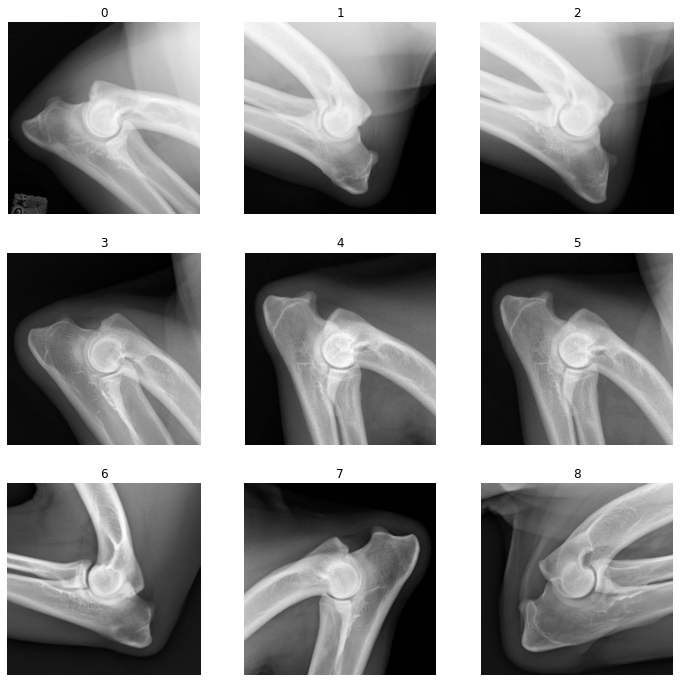

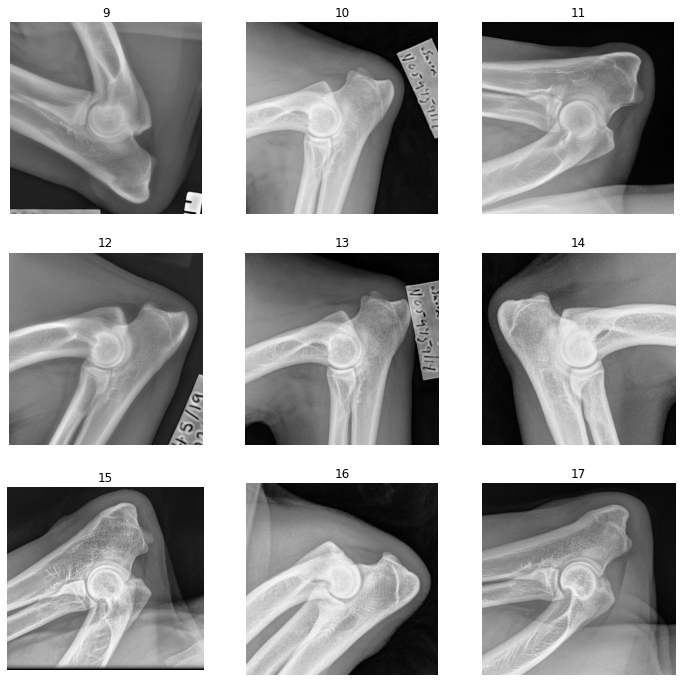

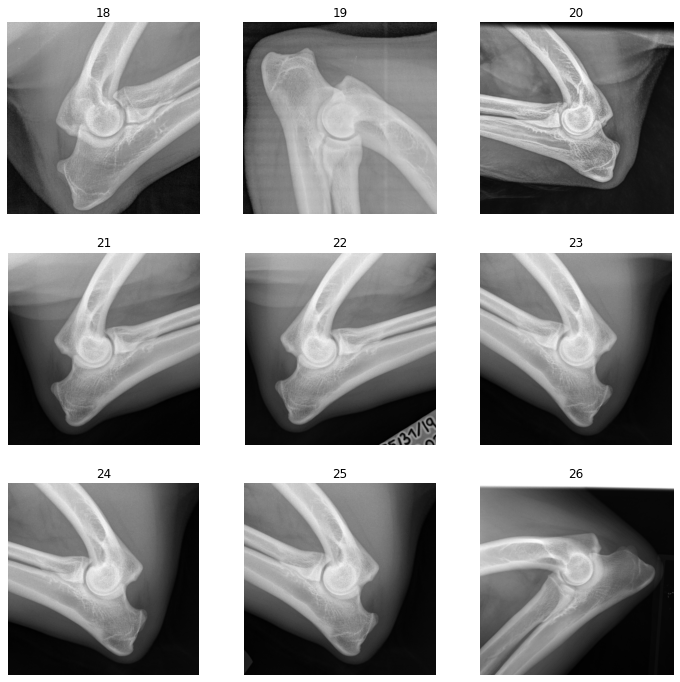

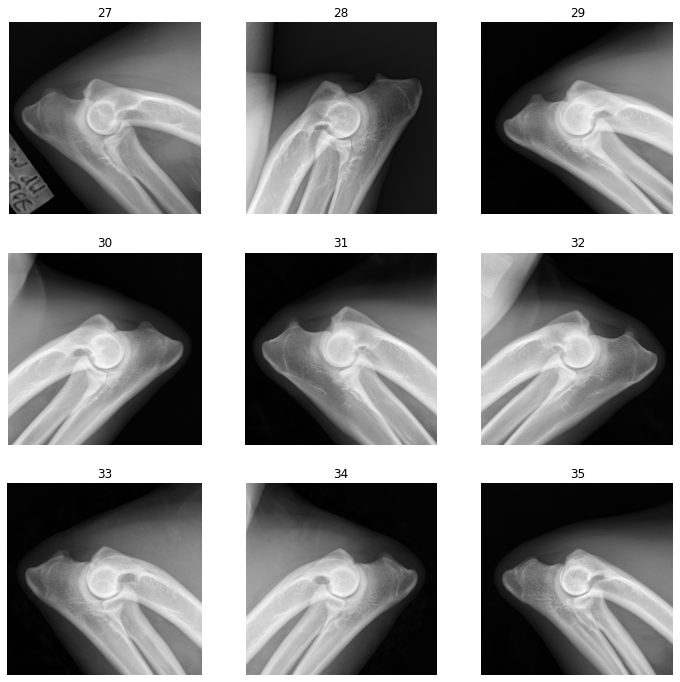

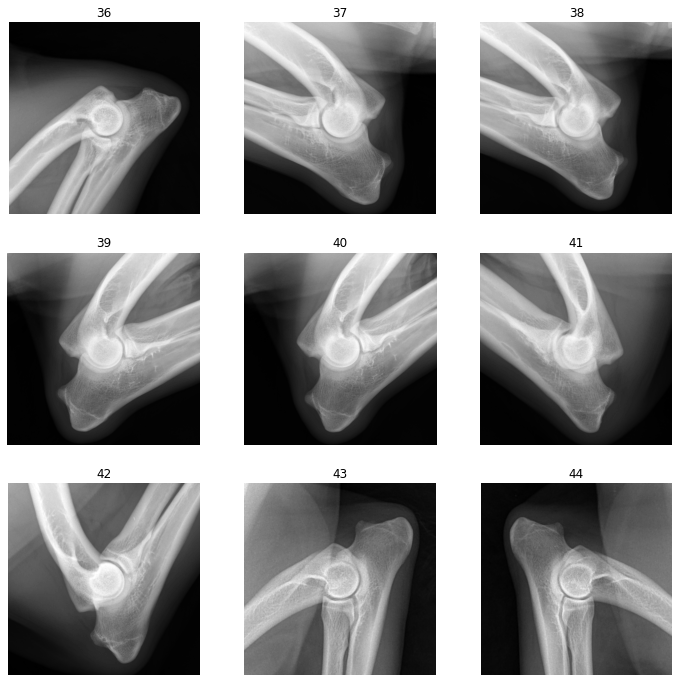

...

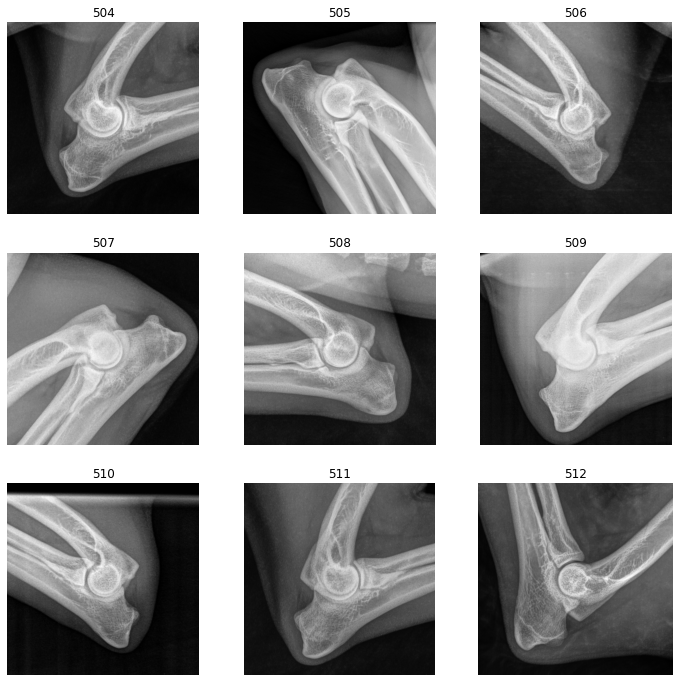

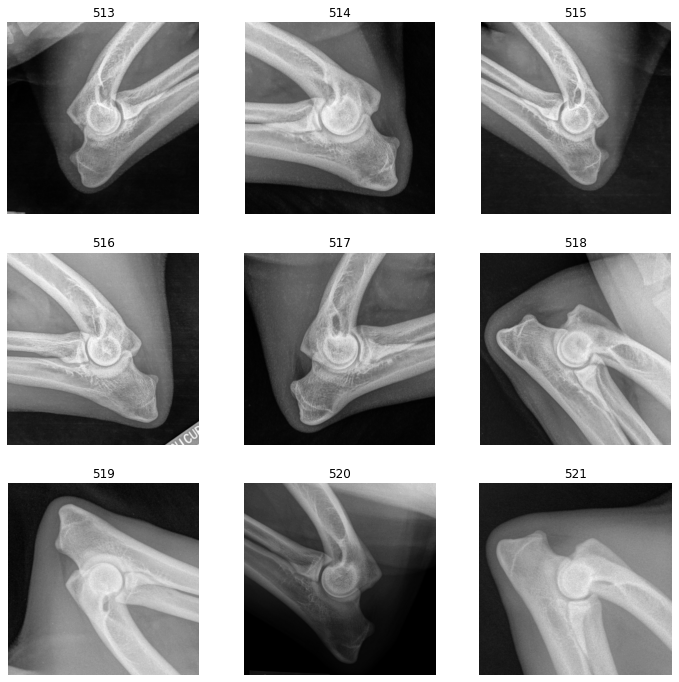

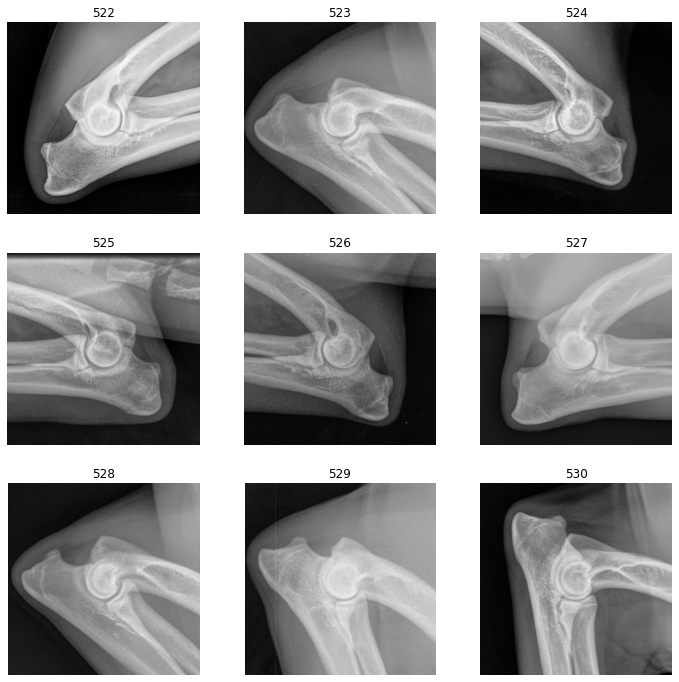

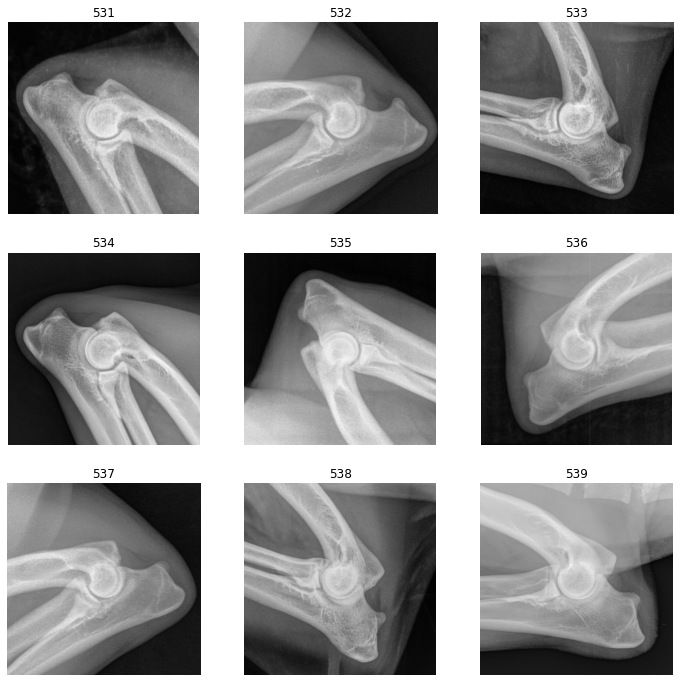

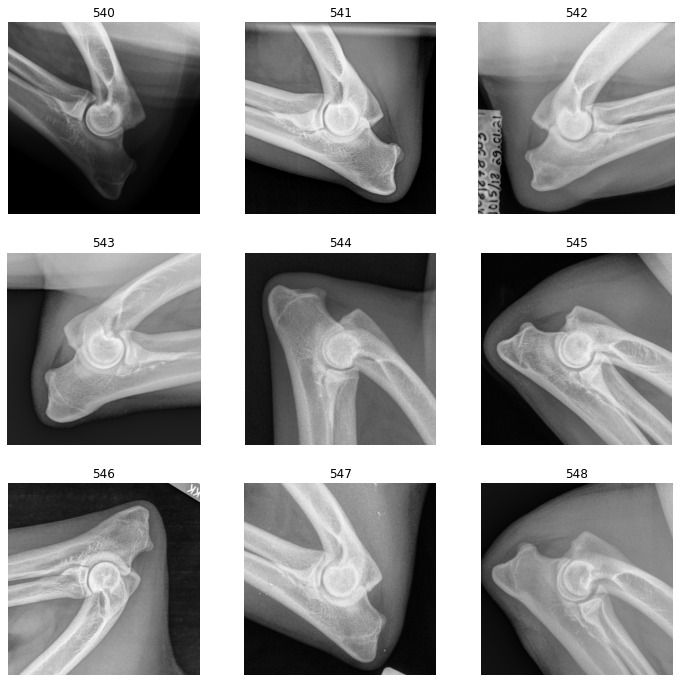

C:\NMBU\TEMP\ipykernel_30372\89006417.py:5: UserWarning: Attempting to set identical left == right == -0.5 results in singular transformations; automatically expanding.
  plt.imshow(img, 'gray')
C:\NMBU\TEMP\ipykernel_30372\89006417.py:5: UserWarning: Attempting to set identical bottom == top == -0.5 results in singular transformations; automatically expanding.
  plt.imshow(img, 'gray')


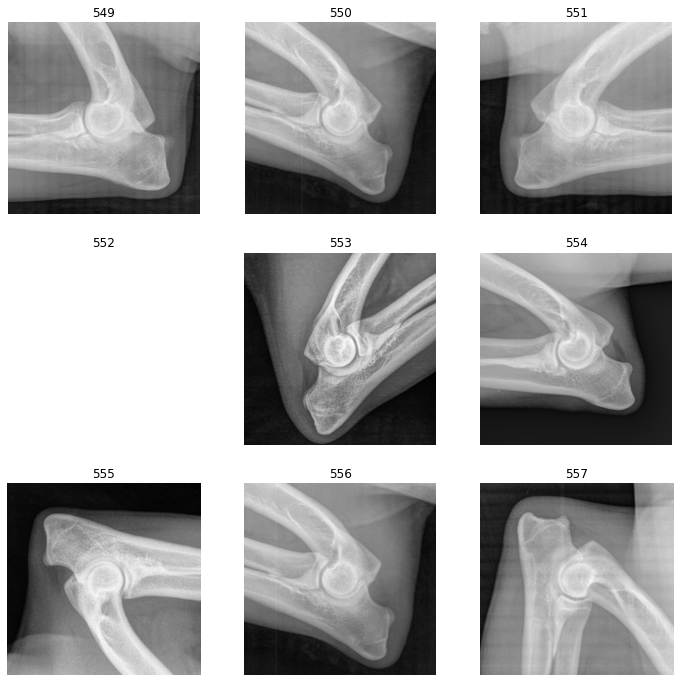

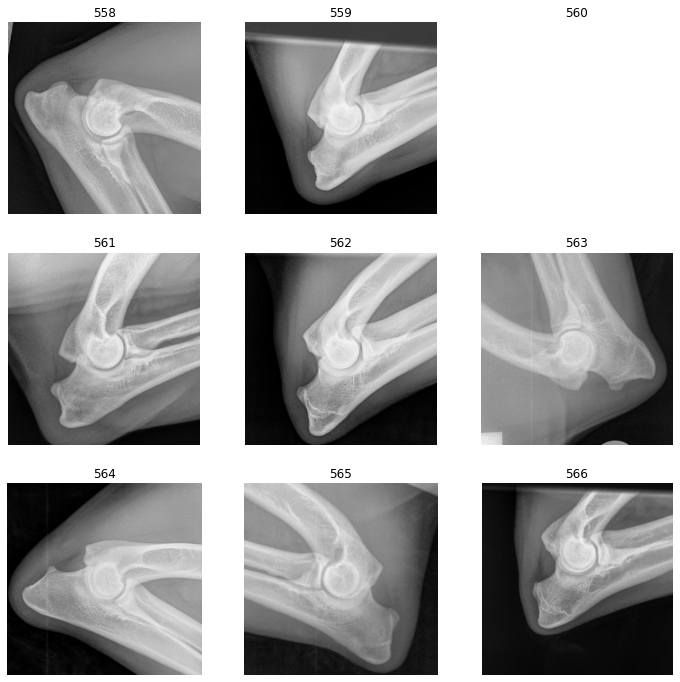

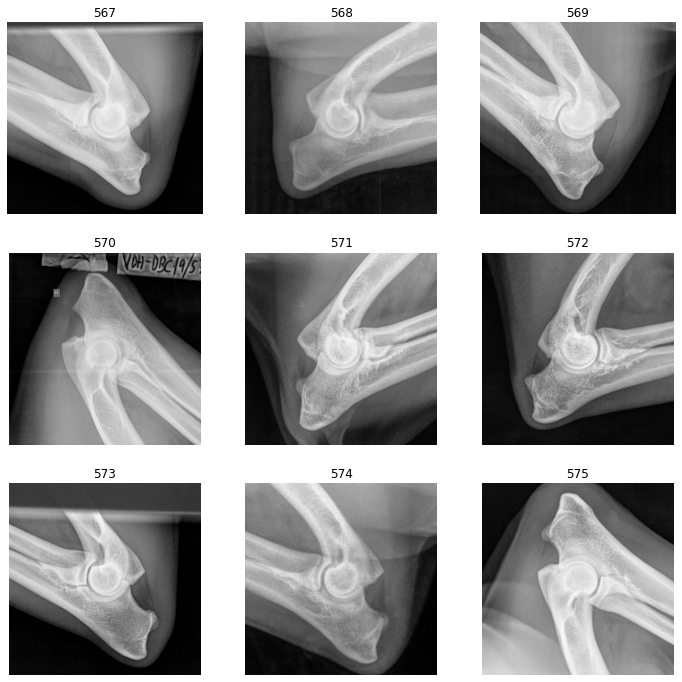

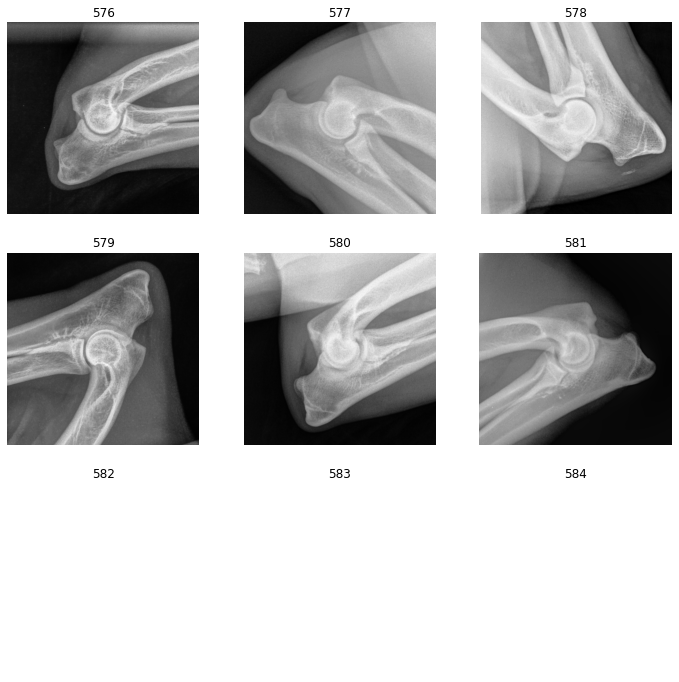

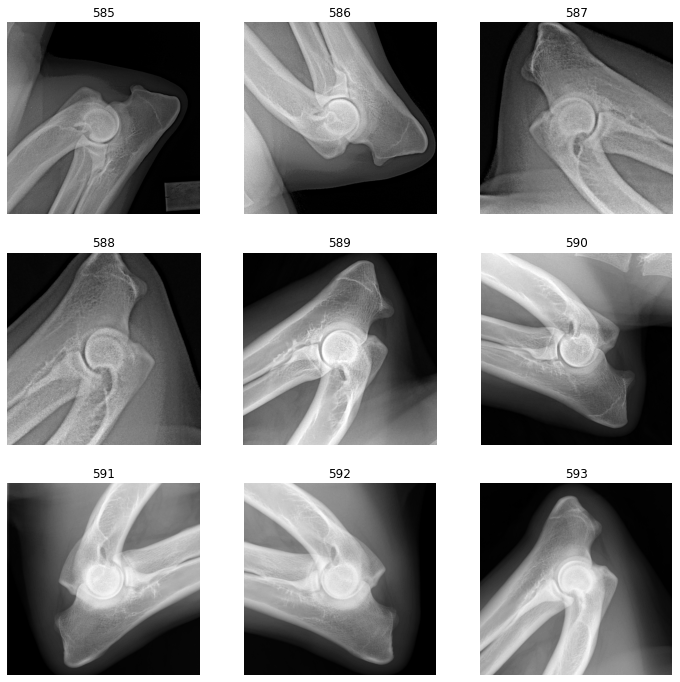

...

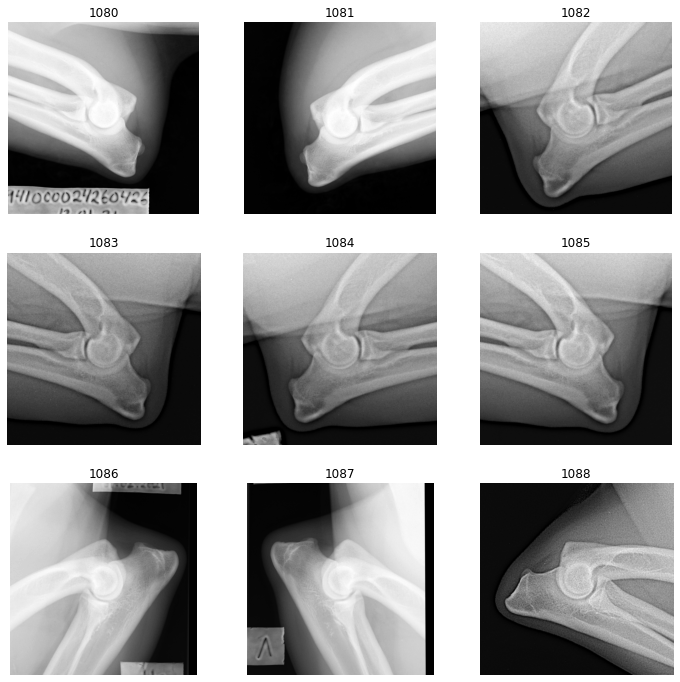

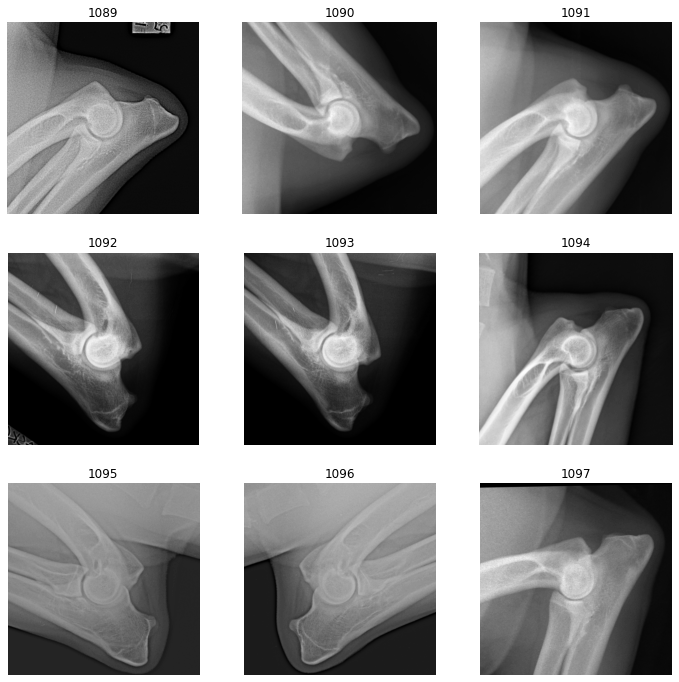

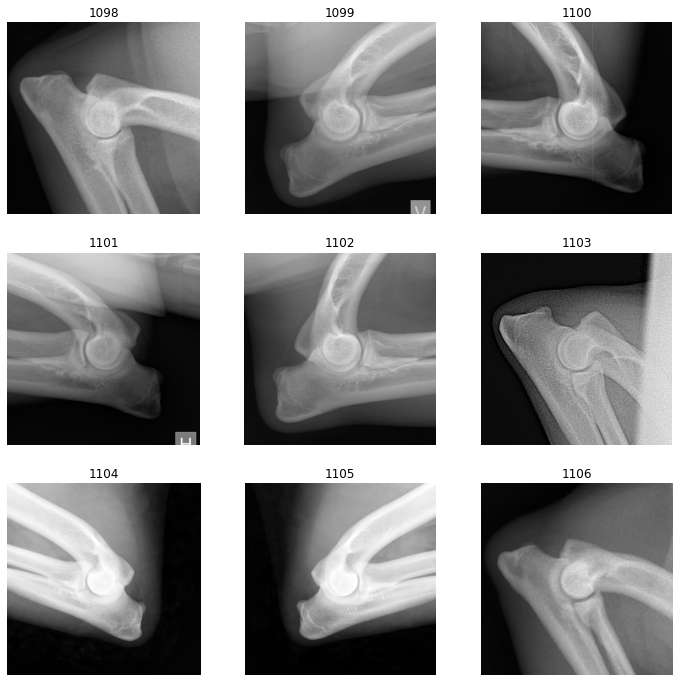

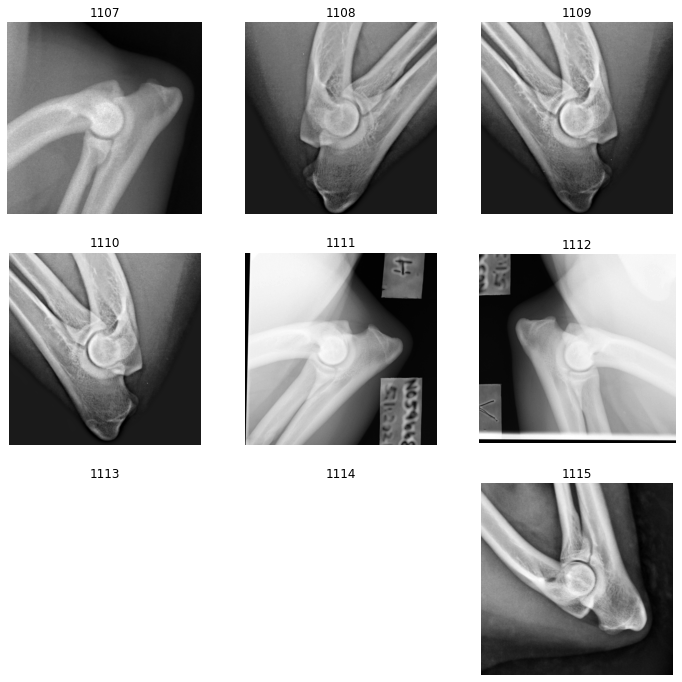

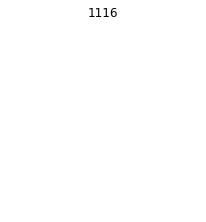

In [8]:
for id, item in detection_df.iterrows():
    fn = item['filename']
    img = np.load(saved_cropped_image + '/' + fn + '.npy')
    plt.subplot(3,3, (id%9) + 1)
    plt.imshow(img, 'gray')
    plt.axis('off')
    plt.title(str(id))
    
    if (id%9) == 8:
        plt.show()
        
plt.show()

## Remove bad detection items

In [9]:
remove_indice = [552,  560,  582,
             583,  584,  790,  966,  967,  968, 1028, 1029, 1039, 1054, 1113, 1114, 1116]
detection_df[~detection_df.index.isin(remove_indice)]

,base_path,filename,ax0_min,ax0_max,ax1_min,ax1_max,confidence,diagnosis,diagnosis_raw
0,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.95.17743.20200127.103203.0.dcm,556,705,626,775,0.999581,0,0
1,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.95.31635.20200909.182350.0.dcm,711,870,1389,1548,0.989332,0,0
2,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.95.31635.20200923.120952.0.dcm,980,1139,1175,1335,0.999967,0,0
3,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.95.32121.20200430.152303.0.dcm,1579,1805,1143,1371,0.990943,0,0
4,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.95.32121.20201217.152659.0.dcm,1208,1402,908,1101,0.999899,0,0
...,...,...,...,...,...,...,...,...,...
1109,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.82.1.1.1430.669053978.192.168.20.148...,1145,1297,1505,1657,0.999991,0,0
1110,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.82.1.1.1430.669053978.192.168.20.148...,1166,1324,1462,1620,0.999887,0,0
1111,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.95.17743.20210105.132747.0.dcm,324,460,236,372,0.878606,0,0
1112,//nmbu.no/LargeFile/Project/CubiAI/sortering/d...,1.2.276.0.95.17743.20210105.132851.0.dcm,502,641,367,507,0.752250,0,0


In [10]:
new_detection_df = detection_df[~detection_df.index.isin(remove_indice)]

In [11]:
new_detection_df.to_csv(filename_clean, index=False)